# Part 2: Advanced Multi-Index Land Cover Classification

---

## Introduction

This tutorial demonstrates an advanced methodology for land cover classification using multi-spectral satellite imagery and spectral indices. We build upon Part 1 by incorporating:

- **Enhanced spectral indices** (NUAI (custom index), BSI, NDVI,MNDWI and brightness)
- **Canopy Height Model (CHM)** for structure-based discrimination
- **Multi-criteria rule based algorithm** for robust classification

### Objectives

1. Load and preprocess Sentinel-2 imagery
2. Calculate advanced vegetation and urban indices
3. Integrate height data from IGN (French National Geographic Institute)
4. Classify five land cover types: **Water, Forest, Agricultural Fields, Bare Soil, and Urban Areas**
5. Validate results and compute area statistics

### Study Area

**Location:** Brittany region, France  
**Satellite:** Sentinel-2 (10m resolution)  
**Bands used:** Blue (B2), Green (B3), Red (B4), NIR (B8), SWIR1 (B11), SWIR2 (B12)

---

## 1. Setup and Data Loading

### 1.1 Import Required Libraries

We'll use:
- **rioxarray**: For reading geospatial raster data
- **numpy**: For numerical operations
- **matplotlib**: For visualization
- **rasterio**: For raster I/O operations
- **owslib**: For accessing IGN's WMS services (height data)
- **xarray**: For working with multi-dimensional arrays

In [1]:
import rioxarray
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import rasterio
from owslib.wms import WebMapService
from rasterio.io import MemoryFile
import xarray as xr
from matplotlib.patches import Patch


### 1.2 Load Sentinel-2 Imagery

Load a Sentinel-2 composite image. This image should contain at least the following bands:
- Band 1: Blue (B2 - 490nm)
- Band 2: Green (B3 - 560nm)  
- Band 3: Red (B4 - 665nm)
- Band 4: NIR (B8 - 842nm)
- Band 5: SWIR1 (B11 - 1610nm)
- Band 6: SWIR2 (B12 - 2190nm)

In [ ]:

# Open the satellite image
img_path = "data/composite_2020_Q2.tif"
img = rioxarray.open_rasterio(img_path)
print(f"Image shape: {img.shape}")
print(f"Bands: {img.band.values}")
print(f"CRS: {img.rio.crs}")

Image shape: (7, 2770, 3679)
Bands: [1 2 3 4 5 6 7]
CRS: EPSG:32630


### 1.3 Data Preprocessing

Clean the image by:
1. **Removing NaN values** (missing data)
2. **Clipping to valid range** (0-1 for reflectance)
3. **Extracting individual bands** for easier manipulation

In [3]:
# Mask negative values
img_clean = img.copy().astype("float32")  
list_name_band = img.attrs['long_name']
bands = img.band.values
print(f"Bands list: {list_name_band}")

all_values = img_clean.values[~np.isnan(img.values)]
negatives_values = all_values[all_values < 0]
print(f"  negative values found: {negatives_values}")

img_clean = img_clean.where(img_clean > 0) # Replace Negative values with Nan

scl = (img_clean.sel(band=bands[-1]) *10000).astype("int") # All the bands were divided by 10,000 during downloading, so I have to scale them back to a class between 0 and 11

valid_pixels = scl.isin([4, 5, 6])  # Vegetation, Not-vegetated, Water
img_clean = img_clean.where(valid_pixels)

for b in range(0, len(bands)-1):
    band = bands[b] 
    img_clean.loc[dict(band=band)] = img_clean.sel(band=band).clip(max=1.0) # Ensure values are between 0 and 1

print(f"Reflectance range: {img_clean.sel(band=slice(bands[0],bands[-1])).min():.4f} - {img_clean.sel(band=slice(bands[0],bands[-1])).max():.4f}")


Bands list: ('B02', 'B03', 'B04', 'B08', 'B8A', 'B11', 'SCL')
  negative values found: [-0.0095 -0.0014 -0.0014 -0.0014 -0.0014]
Reflectance range: 0.0004 - 1.0000


### 1.4 Visualize True Color Composite

Create an RGB visualization to understand the study area. We use bands:
- **Red channel**: Red band (B4)
- **Green channel**: Green band (B3)
- **Blue channel**: Blue band (B2)

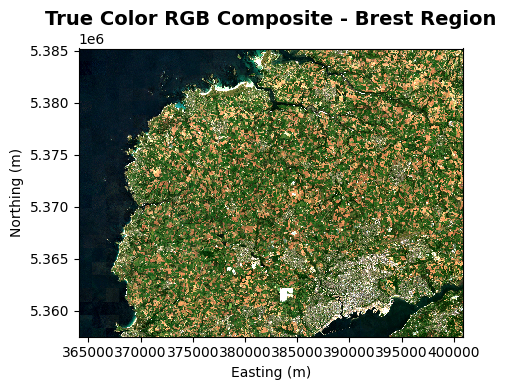

In [4]:
# Display RGB composite
fig, ax = plt.subplots(figsize=(5, 4))
img_clean.sel(band=[3, 2, 1]).plot.imshow(ax=ax, robust=True)
ax.set_title("True Color RGB Composite - Brest Region", fontsize=14, fontweight='bold')
ax.set_xlabel("Easting (m)")
ax.set_ylabel("Northing (m)")
plt.tight_layout()
plt.show()

Classifying pixels in this image will be more challenging than in the Ambazac region image due to the presence of more urban areas and bare soil.

### 1.5 Data Statistics

Let's examine the statistical distribution of pixel values across all bands.

In [5]:
list_name_band = img.attrs['long_name']
bands = img.band.values

print("\n" + "=" * 90)
print(f"{"":<35}DATA STATISTICS")
print("=" * 90)
print(f"\n{'Band':<10} {'Min':<10} {'Max':<10} {'Mean':<10} {'Std':<10} {'98th percentile':<18} {'Nan values (%)':<10}")
print("-" * 90)

outlier_limit_band = []

for b in range(0, len(bands)-1):
    band = bands[b]
    band_da = img_clean.sel(band=band)               
    data_array = band_da.values.flatten()
 
    min_val = float(np.nanmin(band_da))
    max_val = float(np.nanmax(band_da))
    mean_val = float(np.nanmean(band_da))
    std_val = float(np.nanstd(band_da))
    p98 = float(band_da.quantile(0.98, skipna=True))

      # Count NaN values
    nan_count = np.isnan(data_array).sum()
    nan_percent = (nan_count / len(data_array)) * 100
    
 
    print(f"{list_name_band[b]:<10} {min_val:<10.3f} {max_val:<10.3f} {mean_val:<10.3f} "
          f"{std_val:<15.3f} {p98:<17.3f} {nan_percent:<10.2f}")



                                   DATA STATISTICS

Band       Min        Max        Mean       Std        98th percentile    Nan values (%)
------------------------------------------------------------------------------------------
B02        0.006      1.000      0.049      0.027           0.118             0.20      
B03        0.010      1.000      0.072      0.034           0.147             0.20      
B04        0.005      1.000      0.066      0.047           0.177             0.20      
B08        0.002      1.000      0.278      0.159           0.521             0.20      
B8A        0.001      1.000      0.282      0.158           0.520             0.20      
B11        0.003      1.000      0.192      0.107           0.373             0.20      


### 1.5 Extract Spectral Bands

Let's extract the individual bands we'll need for our analysis.


In [6]:
# Extract individual spectral bands
blue = img_clean.sel(band=1)    # B2: Blue (490nm)
green = img_clean.sel(band=2)   # B3: Green (560nm)
red = img_clean.sel(band=3)     # B4: Red (665nm)
nir = img_clean.sel(band=4)     # B8: Near-Infrared (842nm)
swir1 = img_clean.sel(band=5)   # B11: SWIR1 (1610nm)
swir2 = img_clean.sel(band=6)   # B12: SWIR2 (2190nm)



print("Bands extracted successfully!")
print(f"Blue range: {float(blue.min()):.3f} - {float(blue.max()):.3f}")
print(f"NIR range: {float(nir.min()):.3f} - {float(nir.max()):.3f}")

Bands extracted successfully!
Blue range: 0.006 - 1.000
NIR range: 0.002 - 1.000


---

## 2. Spectral Indices Calculation

Spectral indices combine different bands to enhance specific land cover features. We'll calculate multiple indices to capture different aspects of land cover:

### 2.1 Vegetation Indices

**NDVI (Normalized Difference Vegetation Index)**


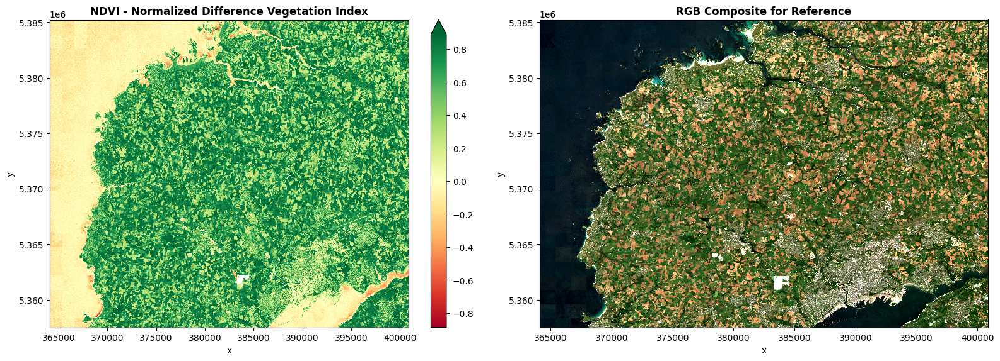

NDVI Statistics:
  Min: -0.857
  Max: 0.944
  Mean: 0.470


In [7]:
# Calculate NDVI
ndvi = (nir - red) / (nir + red)

# Visualize NDVI
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

ndvi.plot(ax=axes[0], cmap='RdYlGn', robust=True)
axes[0].set_title("NDVI - Normalized Difference Vegetation Index", fontweight='bold')

img_clean.sel(band=[3, 2, 1]).plot.imshow(ax=axes[1], robust=True)
axes[1].set_title("RGB Composite for Reference", fontweight='bold')

plt.tight_layout()
plt.show()

print(f"NDVI Statistics:")
print(f"  Min: {float(ndvi.min()):.3f}")
print(f"  Max: {float(ndvi.max()):.3f}")
print(f"  Mean: {float(ndvi.mean()):.3f}")

**Applying an NDVI threshold > 0**

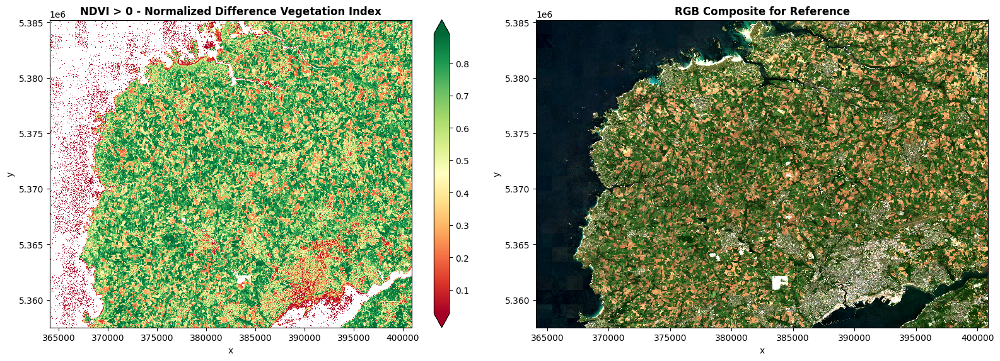

NDVI Statistics:
  Min: 0.000
  Max: 0.944
  Mean: 0.593


In [8]:
# We classified vegetation using an NDVI threshold > 0
ndvi_filter = ndvi.where(ndvi>0)
# Visualize NDVI
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

ndvi_filter.plot(ax=axes[0], cmap='RdYlGn', robust=True)
axes[0].set_title("NDVI > 0 - Normalized Difference Vegetation Index", fontweight='bold')

img_clean.sel(band=[3, 2, 1]).plot.imshow(ax=axes[1], robust=True)
axes[1].set_title("RGB Composite for Reference", fontweight='bold')

plt.tight_layout()
plt.show()

print(f"NDVI Statistics:")
print(f"  Min: {float(ndvi_filter.min()):.3f}")
print(f"  Max: {float(ndvi_filter.max()):.3f}")
print(f"  Mean: {float(ndvi_filter.mean()):.3f}")

In the figures above, we observe that pixels with NDVI < 0 generally correspond to water bodies. However, some red pixels still appear in the ocean areas. To improve water body detection, an additional spectral index should be used alongside NDVI.

Next, let’s apply a different filter to better classify built-up areas and bare soil.

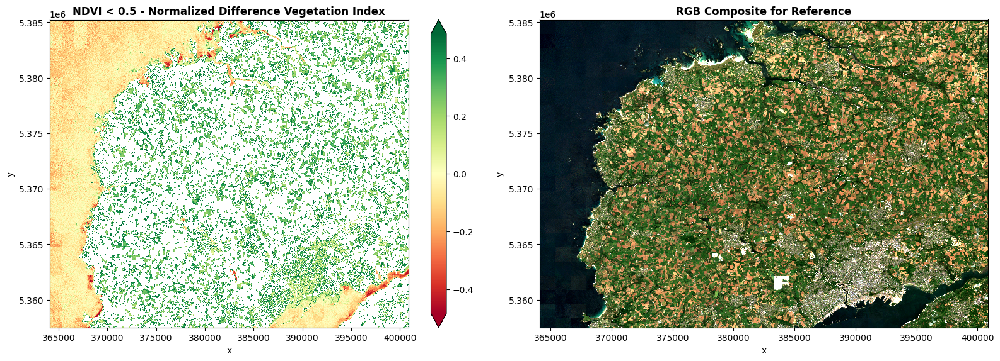

NDVI Statistics:
  Min: -0.857
  Max: 0.500
  Mean: 0.137


In [9]:
# We classified vegetation using an NDVI threshold < 0.5
ndvi_filter = ndvi.where(ndvi<0.5)
# Visualize NDVI
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

ndvi_filter.plot(ax=axes[0], cmap='RdYlGn', robust=True)
axes[0].set_title("NDVI < 0.5 - Normalized Difference Vegetation Index", fontweight='bold')

img_clean.sel(band=[3, 2, 1]).plot.imshow(ax=axes[1], robust=True)
axes[1].set_title("RGB Composite for Reference", fontweight='bold')

plt.tight_layout()
plt.show()

print(f"NDVI Statistics:")
print(f"  Min: {float(ndvi_filter.min()):.3f}")
print(f"  Max: {float(ndvi_filter.max()):.3f}")
print(f"  Mean: {float(ndvi_filter.mean()):.3f}")

Applying an NDVI threshold < 0.5 can help detect urban areas and bare soil, but this approach lacks robustness for classification. Vegetation—depending on its health, growth stage, or type (e.g., sparse or stressed) may also exhibit low NDVI values. However, we can confidently classify pixels with NDVI > 0.5 as vegetation.

To improve water body detection, the decision tree should first separate water pixels from land pixels (e.g., using a water-specific index like MNDWI or NDWI). This step eliminates misclassified positive-NDVI pixels in ocean/large water bodies before further land-cover analysis.

### 2.2 Water Indices

**MNDWI (Modified Normalized Difference Water Index)**


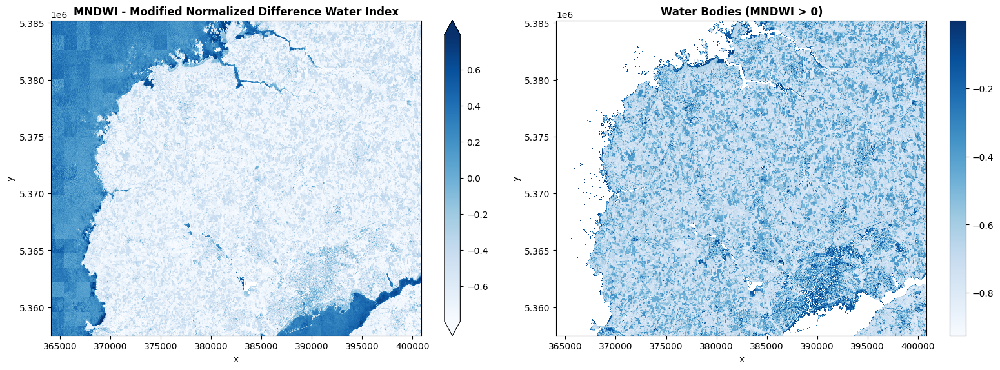

MNDWI Statistics:
  Min: -0.927
  Max: 0.959
  Water pixels (MNDWI > 0): 2,145,069


In [10]:
# Calculate MNDWI
mndwi = (green - swir1) / (green + swir1)

# Visualize MNDWI
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

mndwi.plot(ax=axes[0], cmap='Blues', robust=True)
axes[0].set_title("MNDWI - Modified Normalized Difference Water Index", fontweight='bold')

# Show only water (MNDWI > 0)
mndwi_water = mndwi.where(mndwi < 0)
mndwi_water.plot(ax=axes[1], cmap='Blues')
axes[1].set_title("Water Bodies (MNDWI > 0)", fontweight='bold')

plt.tight_layout()
plt.show()

print(f"MNDWI Statistics:")
print(f"  Min: {float(mndwi.min()):.3f}")
print(f"  Max: {float(mndwi.max()):.3f}")
print(f"  Water pixels (MNDWI > 0): {(mndwi > 0).sum().values:,}")

As seen in the second image of this figure, MNDWI effectively separates water body pixels from land pixels.

### 2.3 Spectral Band Characteristics

**Plotting available bands to analyze their spectral values**



Before selecting new indices for this tutorial, we will first plot all available bands to analyze their spectral values. This step will help us identify which bands are most useful for classifying pixels based on their reflectance characteristics.

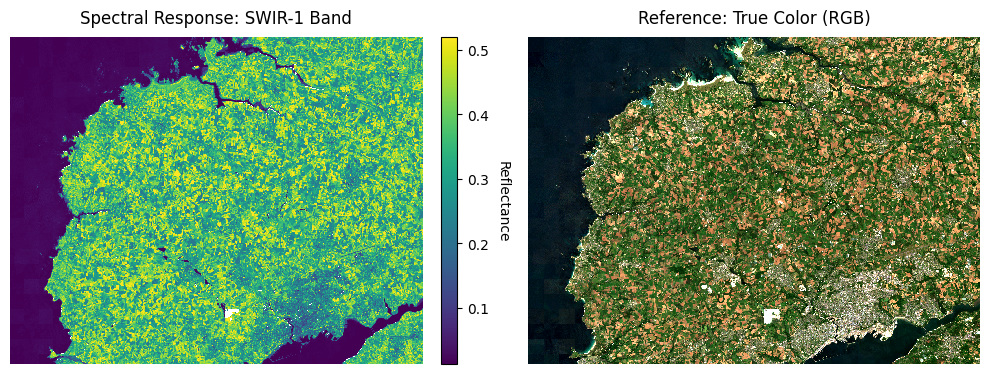

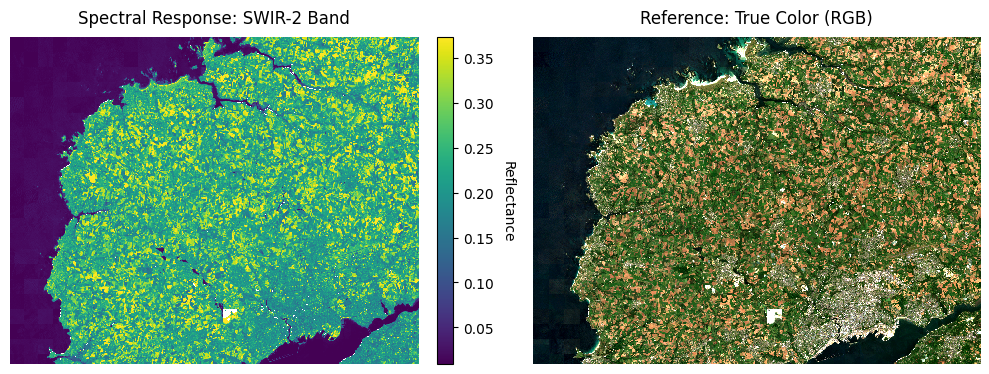

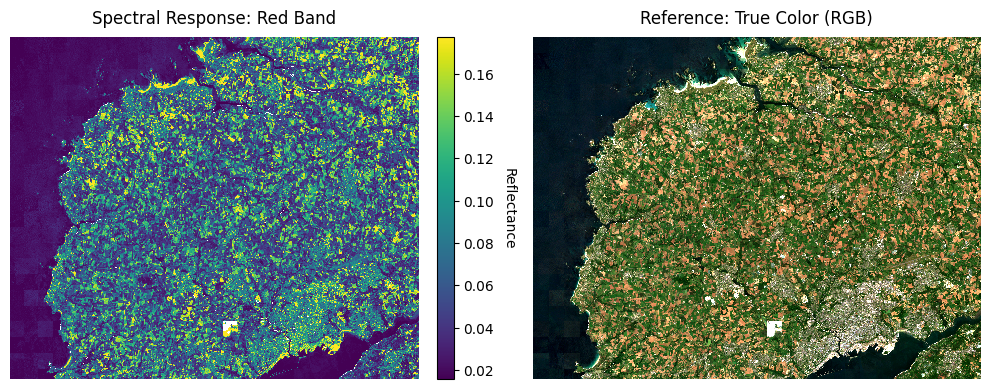

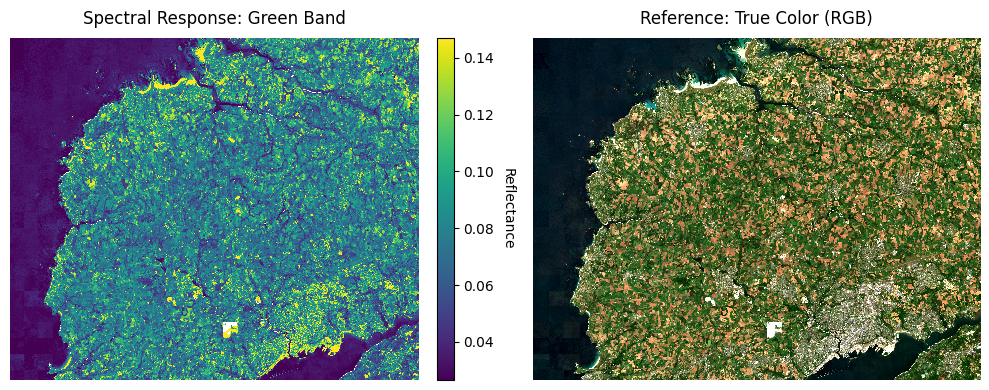

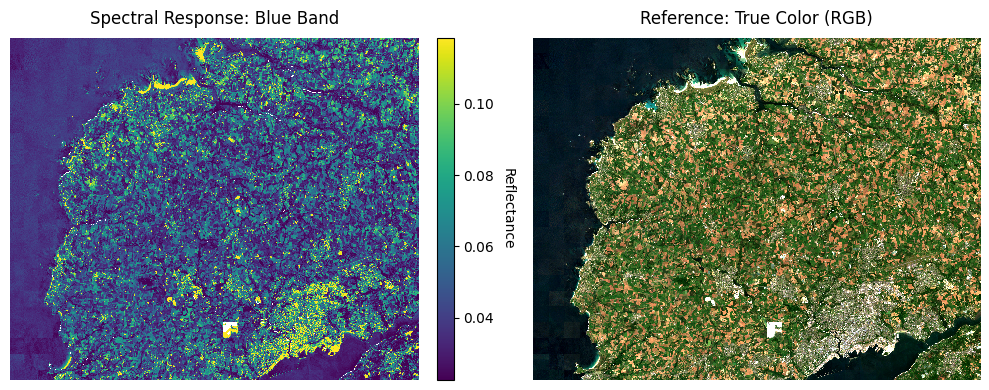

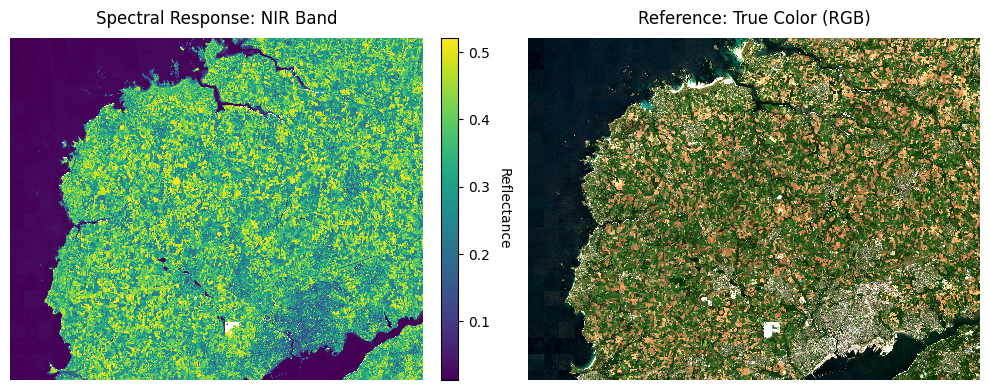

In [11]:

bands = [swir1, swir2, red, green, blue, nir]
band_names = ["SWIR-1", "SWIR-2", "Red", "Green", "Blue", "NIR"] 

for band, band_name in zip(bands, band_names):
    # Initialize subplots with adjusted spacing
    fig, (ax_spectral, ax_rgb) = plt.subplots( 1, 2,figsize=(10, 4))

    band.plot(ax=ax_spectral, cmap='viridis', robust=True, add_colorbar=False)
    cbar = fig.colorbar(ax_spectral.collections[0], ax=ax_spectral, fraction=0.046, pad=0.04)
    cbar.set_label('Reflectance', rotation=270, labelpad=15)  # Vertical label
    ax_spectral.set_title(f"Spectral Response: {band_name} Band", pad=10)
    ax_spectral.axis('off')  # Hide axes for cleaner visuals

    # Plot RGB reference (bands 3,2,1 for true color)
    img_clean.sel(band=[3, 2, 1]).plot.imshow(ax=ax_rgb, robust=True, add_colorbar=False)
    ax_rgb.set_title("Reference: True Color (RGB)", pad=10)
    ax_rgb.axis('off')

    # Adjust layout and display
    plt.tight_layout()
    plt.show()


**Plotting bands on a zoomed area for streamlined comparison**

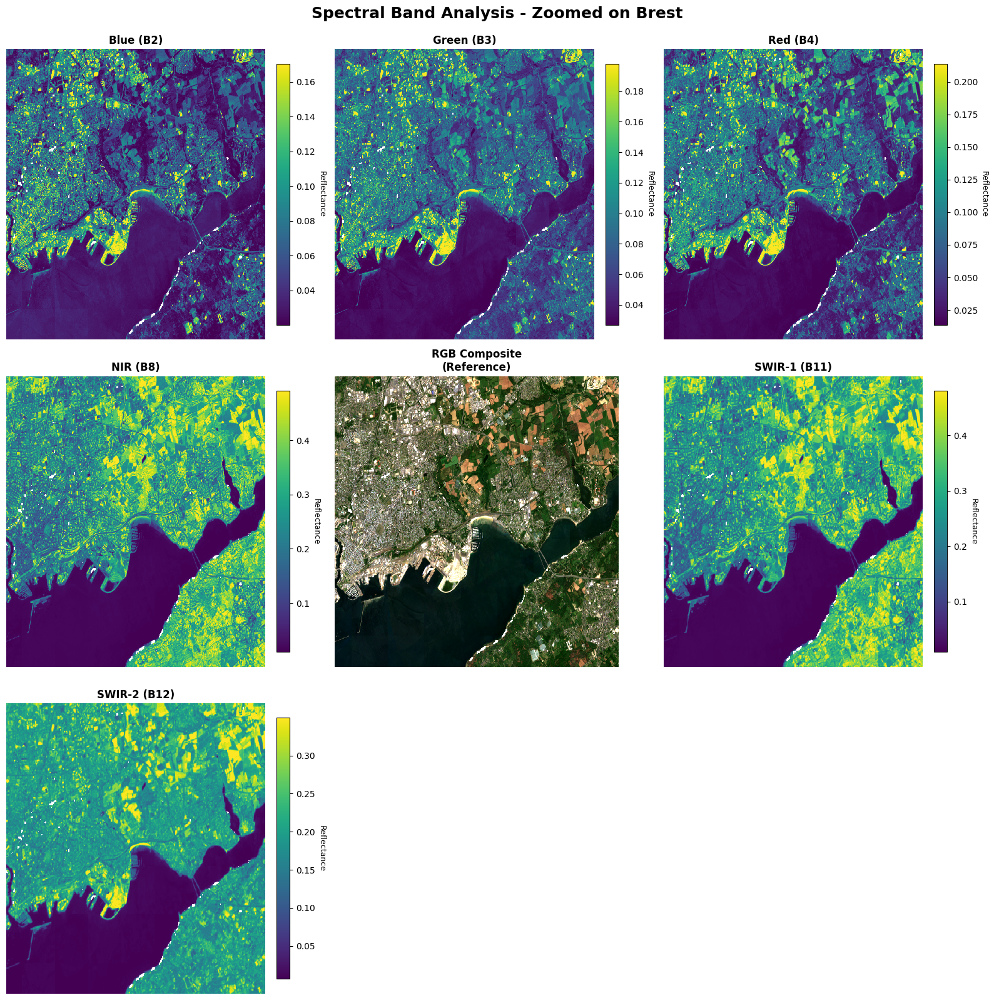

In [12]:
# Define zoom area
y_start, y_end = 2000, 3000
x_start, x_end = 2500, 3500


# Prepare bands
bands = [blue, green, red, nir, swir1, swir2]
band_names = ["Blue (B2)", "Green (B3)", "Red (B4)", "NIR (B8)", "SWIR-1 (B11)", "SWIR-2 (B12)"]

# Create 3x3 grid
fig, axes = plt.subplots(3, 3, figsize=(16, 16))

# Plot spectral bands
positions = [(0,0), (0,1), (0,2), (1,0), (1,2), (2,0)]  # Skip center for RGB

for idx, (band, band_name, pos) in enumerate(zip(bands, band_names, positions)):
    row, col = pos
    band_zoom = band.isel(y=slice(y_start, y_end), x=slice(x_start, x_end))

    im = band_zoom.plot(ax=axes[row, col], cmap='viridis', add_colorbar=False, robust=True)
    cbar = fig.colorbar(im, ax=axes[row, col], fraction=0.046, pad=0.04)
    cbar.set_label('Reflectance', rotation=270, labelpad=12, fontsize=9)
    axes[row, col].set_title(band_name, fontweight='bold', fontsize=12)
    axes[row, col].axis('off')

# RGB in center 
rgb_zoom = img_clean.sel(band=[3, 2, 1]).isel(y=slice(y_start, y_end), x=slice(x_start, x_end))
rgb_zoom.plot.imshow(ax=axes[1, 1], robust=True, add_colorbar=False)
axes[1, 1].set_title("RGB Composite\n(Reference)", fontweight='bold', fontsize=12)
axes[1, 1].axis('off')

# Hide remaining subplots
axes[2, 1].axis('off')
axes[2, 2].axis('off')

fig.suptitle('Spectral Band Analysis - Zoomed on Brest', fontsize=18, fontweight='bold', y=0.995)
plt.tight_layout()
plt.show()

**Spectral Band Characteristics of our image**

| Band  | High values (bright)                              | Medium values                                | Low values (dark)                                  |
|:-----:|:--------------------------------------------------|:---------------------------------------------|:---------------------------------------------------|
| **SWIR1** | Forests, dense vegetation with relatively low water stress | Bare soil, urban areas | Water bodies (strong absorption), very wet surfaces |
| **SWIR2** | Dry bare soil, rocks | Urban areas, vegetation | Water bodies, very moist surfaces                   |
| **Red** | Bare soil, urban areas | Mixed land cover | Healthy vegetation, water bodies                    |
| **Green** | Bare soil, urban areas | Mixed land cover | Vegetation (slightly higher reflectance than red), water bodies |
| **Blue** | Bare soil, urban areas | Mixed land cover | Vegetation and water bodies                        |
| **NIR** | Healthy vegetation  | Partially vegetated or mixed pixels | Water bodies, most urban materials, bare soil |




### 2.4 Custom normalized index for urban areas

We can create our own normalized index using the Blue and SWIR1 bands, following the structure of the NDVI formula. We observed that urban areas have high reflectance in the Blue band and medium reflectance in the SWIR1 band, so we propose:

$$
\text{NUAI} = \frac{\text{SWIR1} - \text{Blue}}{\text{SWIR1} + \text{Blue}}
$$


We will test whether this index can effectively detect and highlight urban areas.


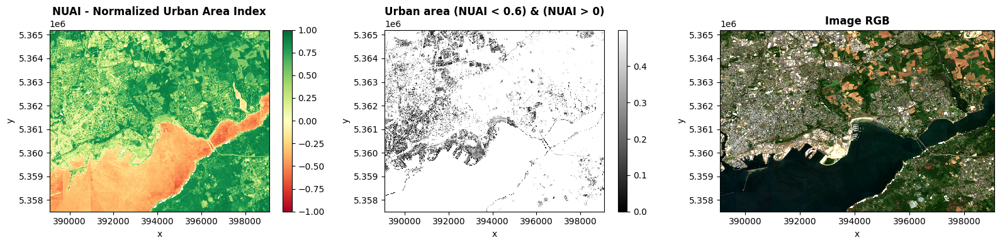

NUAI Statistics:
  Min: -0.729
  Max: 0.953
  Urban pixels (NUAI < 0.6) & (NUAI > 0): 245,888


In [13]:
y_start, y_end = 2000, 3000
x_start, x_end = 2500, 3500

# Calculate NUAI
nuai = (swir1 - blue) / (swir1 + blue)
nuai_zoom = nuai.isel(y=slice(y_start, y_end), x=slice(x_start, x_end))
# Visualize NUAI
fig, axes = plt.subplots(1, 3, figsize=(16, 4))

nuai_zoom.plot(ax=axes[0], cmap='RdYlGn', robust=True, vmin=-1)
axes[0].set_title("NUAI - Normalized Urban Area Index", fontweight='bold')

# Show only uraban and bare soil ((NUAI < 0.6) & (NUAI > 0)
NUAI_urban = nuai_zoom.where((nuai_zoom < 0.5) & (nuai_zoom > 0))
NUAI_urban.plot(ax=axes[1], cmap='grey', vmin=0)
axes[1].set_title("Urban area (NUAI < 0.6) & (NUAI > 0)", fontweight='bold')

rgb_zoom = img_clean.sel(band=[3, 2, 1]).isel(y=slice(y_start, y_end), x=slice(x_start, x_end))
rgb_zoom.sel(band=[3,2,1]).plot.imshow(ax=axes[2],robust =True)
axes[2].set_title("Image RGB", fontweight='bold')

plt.tight_layout()
plt.show()

print(f"NUAI Statistics:")
print(f"  Min: {float(nuai_zoom.min()):.3f}")
print(f"  Max: {float(nuai_zoom.max()):.3f}")
print(f"  Urban pixels (NUAI < 0.6) & (NUAI > 0): {((nuai_zoom < 0.6) & (nuai_zoom > 0)).sum().values:,}")

We successfully detect urban areas, but we still misclassify bare soil, as both surfaces share similar reflectance characteristics in some bands, making them difficult to distinguish using simple indices alone.

### 2.5 Urban and Soil Indices

**2.5.1 BSI (Bare Soil Index)**

$$
\text{BSI} = \frac{\text{(SWIR1 + Red)} - \text{(NIR + Blue)}}{\text{(SWIR1 + Red) } + \text{(NIR + Blue)}}
$$

- **Interpretation**:
  - \> 0: Bare soil, exposed surfaces
  - < 0: Vegetation or water



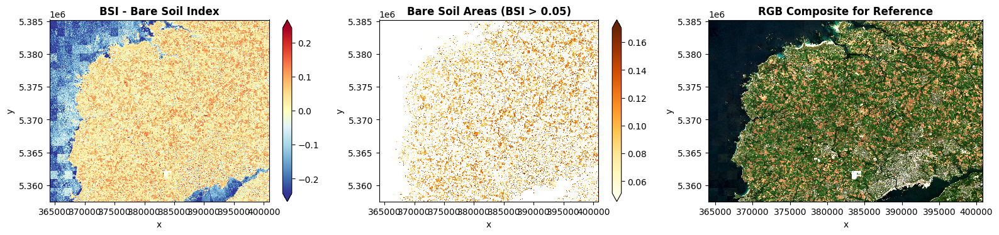

In [14]:
# Calculate BSI (Bare Soil Index)
bsi = ((swir1 + red) - (nir + blue)) / ((swir1 + red) + (nir + blue))


# Visualize both indices
fig, axes = plt.subplots(1, 3, figsize=(16, 4))

bsi.plot(ax=axes[0], cmap='RdYlBu_r', robust=True)
axes[0].set_title("BSI - Bare Soil Index", fontweight='bold')

# Show bare soil (BSI > 0.05)
bare_soil_mask = bsi.where(bsi > 0.05)
bare_soil_mask.plot(ax=axes[1], cmap='YlOrBr', robust=True)
axes[1].set_title("Bare Soil Areas (BSI > 0.05)", fontweight='bold')

img_clean.sel(band=[3, 2, 1]).plot.imshow(ax=axes[2], robust=True)
axes[2].set_title("RGB Composite for Reference", fontweight='bold')

plt.tight_layout()
plt.show()

**Validating BSI with Real Examples**

SWIR-1 mean in Bare Soil area: 0.2369
Red mean in Bare Soil area: 0.1546
NIR mean in Bare Soil area: 0.2365
Blue mean in Bare Soil area: 0.0779
------------------------------
SWIR-1 mean in Vegetation area: 0.5061
Red mean in Vegetation area: 0.0322
NIR mean in Vegetation area: 0.4919
Blue mean in Vegetation area: 0.0271


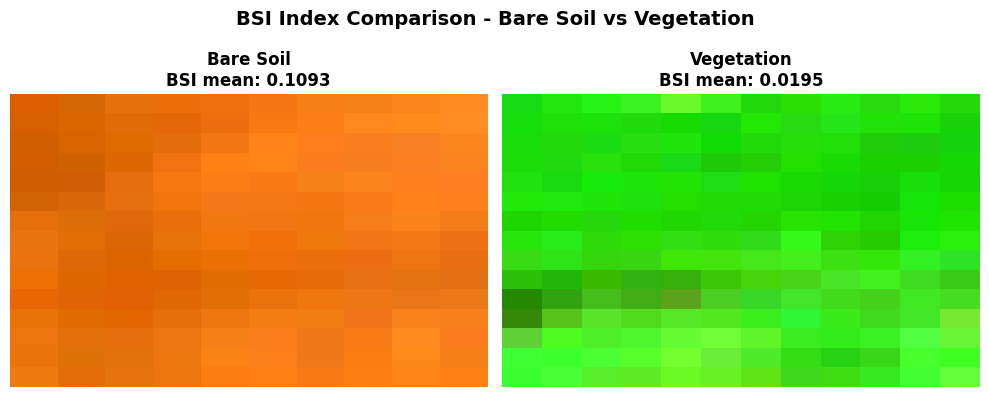

Bare Soil BSI: 0.1093
Vegetation BSI: 0.0195


In [15]:
# Define zoom areas
# Bare soil area
bare_y_start, bare_y_end = 2185, 2200
bare_x_start, bare_x_end = 3365, 3375

# Vegetation area
veg_y_start, veg_y_end = 1178, 1193
veg_x_start, veg_x_end = 2375, 2387

band_list = [swir1, red, nir, blue]
band_names = ["SWIR-1", "Red", "NIR", "Blue"]


# Create figure with 2 subplots
fig, axes = plt.subplots(1, 2, figsize=(10, 4))

# Plot 1: Bare Soil
BSI_bare = bsi.isel(y=slice(bare_y_start, bare_y_end), x=slice(bare_x_start, bare_x_end)).mean().values
rgb_bare = img_clean.sel(band=[3, 2, 1]).isel(y=slice(bare_y_start, bare_y_end), x=slice(bare_x_start, bare_x_end))
rgb_bare.plot.imshow(ax=axes[0], robust=True, add_colorbar=False)
axes[0].set_title(f"Bare Soil\nBSI mean: {round(float(BSI_bare), 4)}", fontweight='bold', fontsize=12)
axes[0].axis('off')
for band, name in zip(band_list, band_names):
    band_bare = band.isel(y=slice(bare_y_start, bare_y_end), x=slice(bare_x_start, bare_x_end))
    band_mean = band_bare.mean().values
    print(f"{name} mean in Bare Soil area: {round(float(band_mean), 4)}")
print("---"*10)
# Plot 2: Vegetation
BSI_veg = bsi.isel(y=slice(veg_y_start, veg_y_end), x=slice(veg_x_start, veg_x_end)).mean().values
rgb_veg = img_clean.sel(band=[3, 2, 1]).isel(y=slice(veg_y_start, veg_y_end), x=slice(veg_x_start, veg_x_end))
rgb_veg.plot.imshow(ax=axes[1], robust=True, add_colorbar=False)
axes[1].set_title(f"Vegetation\nBSI mean: {round(float(BSI_veg), 4)}", fontweight='bold', fontsize=12)
axes[1].axis('off')
for band, name in zip(band_list, band_names):
    band_veg = band.isel(y=slice(veg_y_start, veg_y_end), x=slice(veg_x_start, veg_x_end))
    band_mean = band_veg.mean().values
    print(f"{name} mean in Vegetation area: {round(float(band_mean), 4)}")

# Main title
fig.suptitle('BSI Index Comparison - Bare Soil vs Vegetation', fontsize=14, fontweight='bold', y=0.98)

plt.tight_layout()
plt.show()

print(f"Bare Soil BSI: {round(float(BSI_bare), 4)}")
print(f"Vegetation BSI: {round(float(BSI_veg), 4)}")

This comparison validates that BSI effectively separates bare soil (positive values) from vegetation (values near or below zero). The positive BSI value of 0.1093 for bare soil versus 0.0265 for vegetation demonstrates the index's discriminative power.

**2.5.2 NDBI (Normalized Difference Built-up Index)**


$$
\text{NDBI} = \frac{\text{(SWIR1 - NIR)}} {\text{(SWIR1 + NIR}}
$$


- **Interpretation**:
  - \> 0: Built-up areas, bare surfaces
  - < 0: Vegetation, water

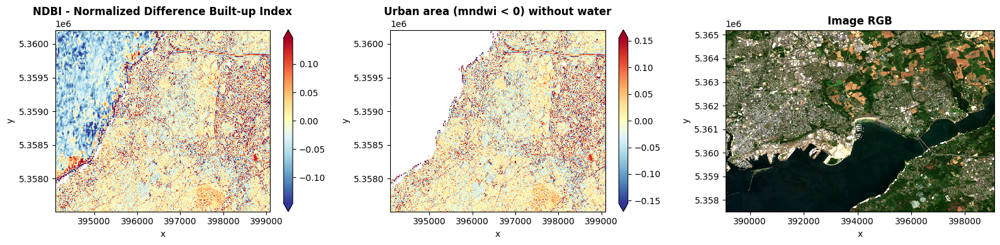

ndbi Statistics:
  Min: -0.549
  Max: 0.715
  Urban pixels (mndwi < 0) without water: 8,024,880


In [16]:
y_start, y_end = 2500, 3000
x_start, x_end = 3000, 3500
# Calculate NDBI (Normalized Difference Built-up Index)
ndbi = (swir1 - nir) / (swir1 + nir)
ndbi_zoom = ndbi.isel(y=slice(y_start, y_end), x=slice(x_start, x_end))

# Visualize ndbi
fig, axes = plt.subplots(1, 3, figsize=(16, 4))

ndbi_zoom.plot(ax=axes[0], cmap='RdYlBu_r', robust=True)
axes[0].set_title("NDBI - Normalized Difference Built-up Index", fontweight='bold')

# Show whithout water
ndbi_urban = ndbi_zoom.where(mndwi < 0)
ndbi_urban.plot(ax=axes[1], cmap='RdYlBu_r' , robust=True)
axes[1].set_title("Urban area (mndwi < 0) without water", fontweight='bold')


rgb_zoom.sel(band=[3,2,1]).plot.imshow(ax=axes[2],robust =True)
#img_clean.sel(band=[3,2,1]).plot.imshow(ax=axes[2],robust =True)
axes[2].set_title("Image RGB", fontweight='bold')

plt.tight_layout()
plt.show()

print(f"ndbi Statistics:")
print(f"  Min: {float(ndbi_zoom.min()):.3f}")
print(f"  Max: {float(ndbi_zoom.max()):.3f}")
print(f"  Urban pixels (mndwi < 0) without water: {(mndwi < 0).sum().values:,}")

**2.5.3 Brightness Index (BI)**

To differentiate between bare soil and urban areas, we use the Brightness Index. In general, bare soil is brighter than urban areas, so it will have higher BI values.

The Brightness Index is defined as the *root–mean–square* of the Red and Green bands:

$$
\text{BI} = \sqrt{\frac{(\text{Red}^2 + \text{Green}^2)}{2}}
$$

link: https://docs.geopera.com/en/docs/spectral-indices/geoeye-1/bi

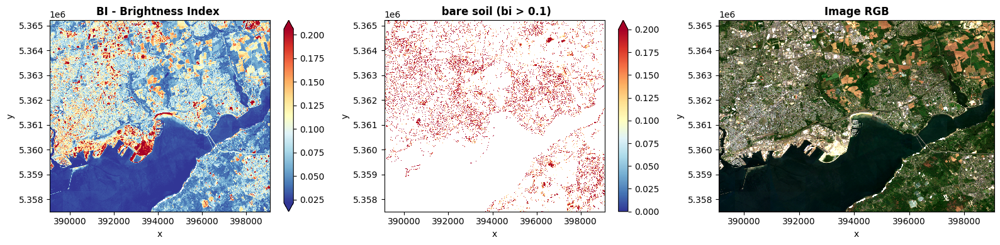

bi Statistics:
  Min: 0.010
  Max: 1.000
  Urban pixels (mndwi < 0) without water: 8,024,880


In [17]:
y_start, y_end = 1500, 2500
x_start, x_end = 2000, 3000

y_start, y_end = 2000, 3000
x_start, x_end = 2500, 3500


# Calculate BI (Brightness Index)
bi = np.sqrt(((red ** 2) + (green ** 2)) / 2)

bi_custom = ((red+green)-nir**2) / (red+green+nir)

# Visualize bi
fig, axes = plt.subplots(1, 3, figsize=(16, 4))

bi.isel(y=slice(y_start, y_end), x=slice(x_start, x_end)).plot(ax=axes[0], cmap='RdYlBu_r', robust=True)
axes[0].set_title("BI - Brightness Index ", fontweight='bold')

# Show only bare soil ((bi < 0.6) & (bi > 0)
bi_urban = bi_custom.isel(y=slice(y_start, y_end), x=slice(x_start, x_end)).where(bi_custom > 0.1).where(bi_custom < 0.3).where(bi < 0.1)
bi_urban.plot(ax=axes[1], cmap='RdYlBu_r' , robust=True,vmin=0,vmax=0.2)
axes[1].set_title(" bare soil (bi > 0.1)", fontweight='bold')


img_clean.sel(band=[3,2,1]).isel(y=slice(y_start, y_end), x=slice(x_start, x_end)).plot.imshow(ax=axes[2],robust =True)
axes[2].set_title("Image RGB", fontweight='bold')

plt.tight_layout()
plt.show()

print(f"bi Statistics:")
print(f"  Min: {float(bi.min()):.3f}")
print(f"  Max: {float(bi.max()):.3f}")
print(f"  Urban pixels (mndwi < 0) without water: {(mndwi < 0).sum().values:,}")


The index is used to assess soil brightness, which is strongly related to soil moisture, salinity, and organic matter content. We can therefore use this index to detect very bright surfaces such as sand and totally bare soil. Combined with our custom NUAI index and the existing BSI and NDBI indices, we should be able to better separate urban areas from bare soil.

We will also add another technique that does not rely on spectral indices: the Canopy Height Model (CHM), which estimates the height of above-ground objects (e.g. buildings, trees) by subtracting the digital terrain model (DTM) from the digital surface model (DSM). Coupled with our previously calculated indices, this additional height information will help us classify the different land-cover classes with greater confidence.


---

## 3. Canopy Height Model (CHM) Integration

### 3.1 Why Height Data?

Spectral indices alone can struggle to differentiate between:
- **Forests** (tall, dense vegetation) vs **Healthy crops** (similar NDVI)
- **Buildings** vs **Bare soil** (similar spectral signatures)

**Solution**: Add height information!

### 3.2 CHM Calculation

**CHM (Canopy Height Model)** = DSM (Digital Surface Model) - DTM (Digital Terrain Model)

- **DSM**: Elevation including trees, buildings, etc.
- **DTM**: Ground elevation only
- **CHM**: Height of objects above ground (trees, buildings)

### 3.3 Data Source

We use **IGN's (French National Geographic Institute) WMS services**:
- **MNS (DSM)**: High-resolution surface model (1-5m)
- **MNT (DTM)**: High-resolution terrain model (1-5m)
- **Resolution**: Automatically resampled to match Sentinel-2 (10m)

**Note**: MNS coverage is limited to areas in France. For global applications, alternatives include:
- **GEDI** (NASA LiDAR)
- **ETH Global Canopy Height**
- **Copernicus DEM**

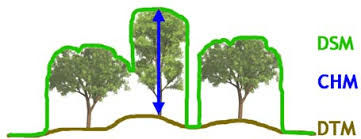


In [18]:
def get_chm_from_wms(sentinel_path, wms_url="https://data.geopf.fr/wms-r/wms"):
    """
    Retrieve DSM and DTM from IGN WMS and compute CHM.
    
    Parameters:
    -----------
    sentinel_path : str
        Path to Sentinel-2 image (used for bounds, size, and CRS)
    wms_url : str
        IGN WMS service URL
    
    Returns:
    --------
    chm_xr : xarray.DataArray
        Canopy Height Model aligned with Sentinel-2 grid
    """
    # Read Sentinel-2 image metadata
    with rasterio.open(sentinel_path) as src:
        bounds = src.bounds
        width = src.width
        height = src.height
        crs = src.crs.to_string()
    
    # Connect to WMS
    wms = WebMapService(wms_url, version='1.3.0')
    
    def get_layer(layer_name):
        """Fetch elevation layer from WMS."""
        img = wms.getmap(
            layers=[layer_name],
            srs=crs,
            bbox=(bounds.left, bounds.bottom, bounds.right, bounds.top),
            size=(width, height),
            format='image/geotiff'
        )
        
        with MemoryFile(img.read()) as memfile:
            with memfile.open() as dataset:
                data = dataset.read(1).astype(float)
                nodata = dataset.nodata
                
                # Replace NoData with NaN
                if nodata is not None:
                    data = np.where(data == nodata, np.nan, data)
                
                # Filter aberrant values 
                data = np.where((data < -50) | (data > 5000), np.nan, data)
                
        return data
    
    # Fetch DSM (MNS) and DTM (MNT)
    print("Fetching DSM (Digital Surface Model)...")
    dsm_data = get_layer("ELEVATION.ELEVATIONGRIDCOVERAGE.HIGHRES.MNS")
    
    print("Fetching DTM (Digital Terrain Model)...")
    dtm_data = get_layer("ELEVATION.ELEVATIONGRIDCOVERAGE.HIGHRES")
    
    # Calculate CHM
    print("Computing CHM (Canopy Height Model)...")
    chm = dsm_data - dtm_data
    
    # Clean CHM (realistic height range for vegetation/buildings)
    chm = np.where(chm < 0, 0, chm)      
    chm = np.where(chm > 60, np.nan, chm) 
    
    # Convert to xarray with proper coordinates
    chm_xr = xr.DataArray(
        chm,
        coords={'y': img_clean.y, 'x': img_clean.x},
        dims=['y', 'x']
    )
    
    # Print statistics
    print(f"\nCHM Statistics:")
    print(f"  Min: {np.nanmin(chm):.2f}m")
    print(f"  Max: {np.nanmax(chm):.2f}m")
    print(f"  Mean: {np.nanmean(chm):.2f}m")
    print(f"  Median: {np.nanmedian(chm):.2f}m")
    
    return chm_xr

In [19]:
# Retrieve CHM from IGN WMS
chm_xr = get_chm_from_wms(img_path)

Fetching DSM (Digital Surface Model)...
Fetching DTM (Digital Terrain Model)...
Computing CHM (Canopy Height Model)...

CHM Statistics:
  Min: 0.00m
  Max: 59.93m
  Mean: 1.82m
  Median: 0.29m


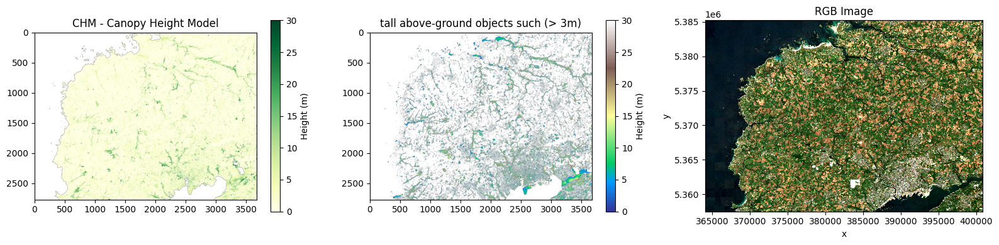

In [20]:
# Visualize CHM and its relation to land cover
fig, axes = plt.subplots(1, 3, figsize=(16, 4))

# CHM
im3 = axes[0].imshow(chm_xr, cmap='YlGn', vmin=0, vmax=30)
axes[0].set_title("CHM - Canopy Height Model")
plt.colorbar(im3, ax=axes[0], label='Height (m)')

# tall above-ground objects such (> 3m) 
chm_high = chm_xr.where(chm_xr > 3)
im3 = axes[1].imshow(chm_high, cmap='terrain', vmin=0, vmax=30)
axes[1].set_title("tall above-ground objects such (> 3m)")
plt.colorbar(im3, ax=axes[1], label='Height (m)')

# RGB for reference
img_clean.sel(band=[3,2,1]).plot.imshow(ax=axes[2], robust=True)
axes[2].set_title("RGB Image")

plt.tight_layout()
plt.show()

In the image above, we can already detect tall above-ground objects such as buildings and tall vegetation. By combining the NDVI index with the Canopy Height Model (CHM), we can more reliably distinguish trees and forest stands from other classes such as urban areas, bare soil, and agricultural fields.

---
## 4. Multi-Index Classification

### 4.2 Classification Logic

The order matters! We apply conditions sequentially:
1. **Water first**: Most distinctive signature
2. **Bare soil**: Before urban (similar spectral signatures)
3. **Urban**: After bare soil, using NUAI range + NDBI + BI
4. **Field**: Medium NDVI +  medium/low height
5. **Forest**: High NDVI + tall height 


### 4.3 Bare soil mask

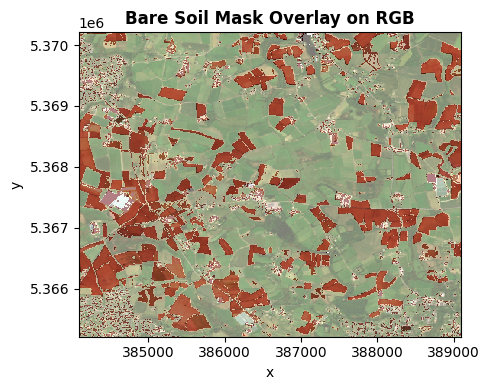

In [110]:
y_start, y_end = 1500, 2000
x_start, x_end = 2000, 2500

#y_start, y_end = 2000, 3000
#x_start, x_end = 2500, 3500

# Create the bare soil mask
bare_soil_mask =  ( (bsi > 0.05)  & (nuai > 0.4) & (chm_xr < 3)  & (ndvi <0.5))  | ((bi > 0.15) & (mndwi < 0.05)) # to detect very bright surface

bare_soil_mask = bare_soil_mask.isel(y=slice(y_start, y_end), x=slice(x_start, x_end))
# Convert mask to integer (0/1)
mask_int_bare_soil = bare_soil_mask.astype(int)

# Get RGB data 
rgb_data = img_clean.sel(band=[3, 2, 1]).transpose('y', 'x', 'band').isel(y=slice(y_start, y_end), x=slice(x_start, x_end))

# Create figure
fig, ax = plt.subplots(1, 1, figsize=(5, 4))

# Plot RGB image
rgb_data.plot.imshow(ax=ax, robust=True)

# Overlay mask with transparency 
mask_int_bare_soil.plot(ax=ax, cmap='Reds', alpha=0.5, add_colorbar=False)

# Add title
ax.set_title("Bare Soil Mask Overlay on RGB", fontweight='bold')

plt.tight_layout()
plt.show()

### 4.4 Urban mask

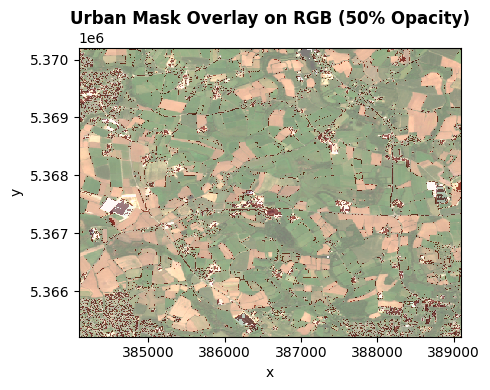

In [108]:


# Create the urban mask
urban_mask = (((nuai > 0) & (nuai < 0.6))| (ndbi >0.05))  & (bi > 0.06) & ~bare_soil_mask & (mndwi < 0)

mask_int_urban = urban_mask.astype(int)

rgb_data = img_clean.sel(band=[3, 2, 1]).transpose('y', 'x', 'band') # Adjust if needed


fig, ax = plt.subplots(1, 1, figsize=(5, 4))
rgb_data.plot.imshow(ax=ax, robust=True)
mask_int_urban.plot(ax=ax, cmap='Reds', alpha=0.5, add_colorbar=False)
ax.set_title("Urban Mask Overlay on RGB (50% Opacity)", fontweight='bold')
plt.tight_layout()
plt.show()


### 4.4 Field soil mask

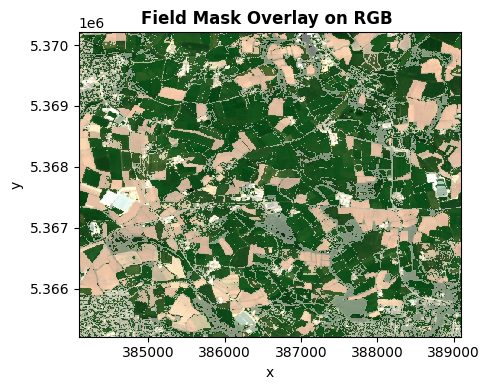

In [24]:

# Create the field mask

field = (ndvi >= 0.3) &  (mndwi <= 0) & (chm_xr < 3)  & ~bare_soil_mask & ~urban_mask

# Convert mask to integer (0/1)
mask_int = field.astype(int)

# Get RGB data 
rgb_data = img_clean.sel(band=[3, 2, 1]).transpose('y', 'x', 'band')

# Create figure
fig, ax = plt.subplots(1, 1, figsize=(5, 4))

# Plot RGB image
rgb_data.plot.imshow(ax=ax, robust=True)

# Overlay mask with transparency 
mask_int.plot(ax=ax, cmap='Greens', alpha=0.5, add_colorbar=False)

# Add title
ax.set_title("Field Mask Overlay on RGB ", fontweight='bold')

plt.tight_layout()
plt.show()


### 4.5 Forest mask

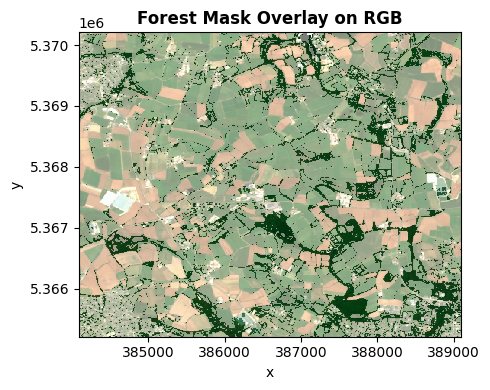

In [25]:

# Create the forest mask

forest =  (ndvi >= 0.5) & (chm_xr > 2.5) & (mndwi <= 0)  &  (mndwi <= 0) & ~urban_mask & ~bare_soil_mask  & ~field

# Convert mask to integer (0/1)
mask_int_forest = forest.astype(int)

# Get RGB data 
rgb_data = img_clean.sel(band=[3, 2, 1]).transpose('y', 'x', 'band')

# Create figure
fig, ax = plt.subplots(1, 1, figsize=(5, 4))

# Plot RGB image
rgb_data.plot.imshow(ax=ax, robust=True)

# Overlay mask with transparency 
mask_int_forest.plot(ax=ax, cmap='Greens', alpha=0.5, add_colorbar=False)

# Add title
ax.set_title("Forest Mask Overlay on RGB", fontweight='bold')

plt.tight_layout()
plt.show()


### 4.5 Classification map

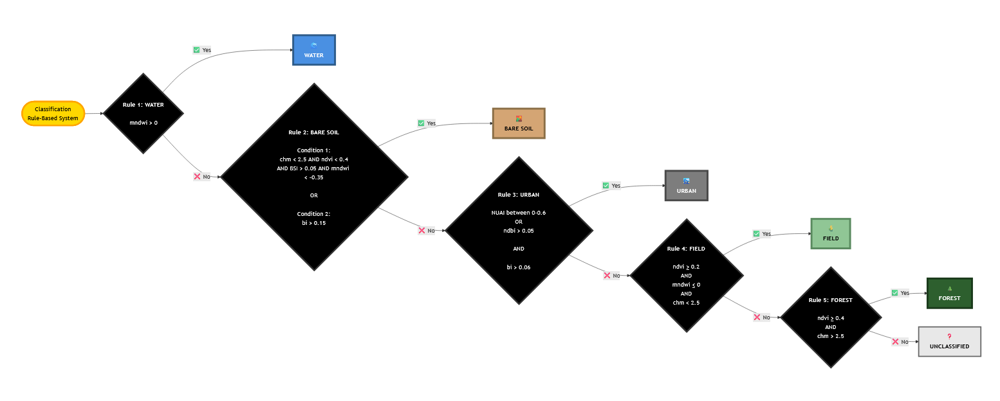

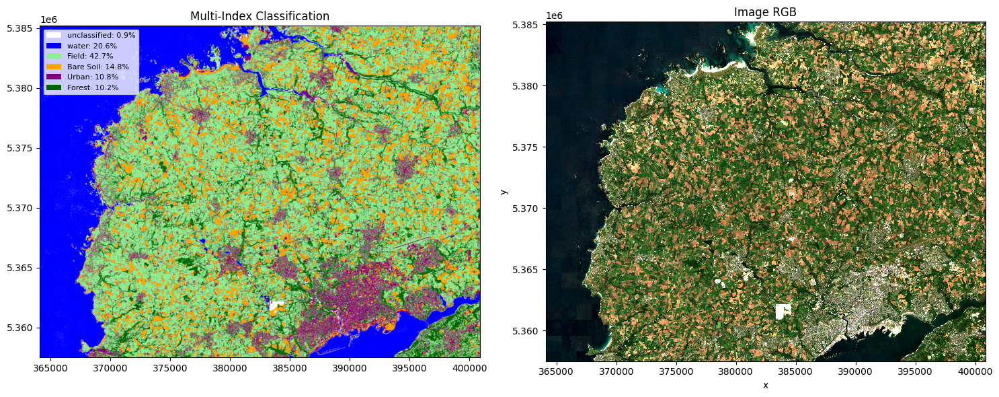

In [103]:
colors = ["white", "blue", "lightgreen", "darkgreen", "orange", "purple"]
cmap = ListedColormap(colors)
chm_xr = chm_xr.fillna(0)
#Rule base classification
water = (mndwi > 0) & (ndvi < 0.1) & (bi < 0.1)
bare_soil_mask =  ( (bsi > 0.05)  & (nuai > 0.45) & (chm_xr < 3)  & (ndvi <0.4))  | ((bi > 0.15) & (mndwi < 0.05)) # to detect very bright surface
urban_mask = (((nuai > 0) & (nuai < 0.62))| ((ndbi >0.05)))  & (bi > 0.05)  & ~water & ~bare_soil_mask 
field = (ndvi >= 0.2) &  (mndwi <= 0) & (chm_xr < 3) & ~water & ~urban_mask & ~bare_soil_mask 
forest = (ndvi >= 0.4) & (chm_xr > 3) & ~water & ~urban_mask & ~bare_soil_mask  & ~field
Unclassified = ~water & ~urban_mask & ~bare_soil_mask  & ~field & ~forest

# Create classification
classified_element = np.select(
    [water, field, forest, bare_soil_mask, urban_mask],
    [0, 1, 2, 3, 4],
    default=-1
)

# Statistiques
water_pct = (water.sum() / water.size * 100).values
field_pct = (field.sum() / field.size * 100).values
bare_pct = (bare_soil_mask.sum() / bare_soil_mask.size * 100).values
urban_pct = (urban_mask.sum() / urban_mask.size * 100).values
forest_pct = (forest.sum() / forest.size * 100).values
Unclassified_pct = (Unclassified.sum() / Unclassified.size * 100).values

# Plot
fig, axes = plt.subplots(1, 2, figsize=(15, 6))
im = axes[0].imshow(
    classified_element,
    cmap=cmap,
    extent=[img_clean.x.min(), img_clean.x.max(),
            img_clean.y.min(), img_clean.y.max()],
    vmin=-1,
    vmax=4
)
img_clean.sel(band=[3,2,1]).plot.imshow(ax=axes[1], robust=True)

legend_elements = [
    Patch(facecolor='white', label=f'unclassified: {Unclassified_pct:.1f}%'),
    Patch(facecolor='blue', label=f'water: {water_pct:.1f}%'),
    Patch(facecolor='lightgreen', label=f'Field: {field_pct:.1f}%'),
    Patch(facecolor='orange', label=f'Bare Soil: {bare_pct:.1f}%'),
    Patch(facecolor='purple', label=f'Urban: {urban_pct:.1f}%'),
    Patch(facecolor='darkgreen', label=f'Forest: {forest_pct:.1f}%')
]

axes[0].legend(handles=legend_elements, loc='upper left', fontsize=8)

axes[0].set_title("Multi-Index Classification")
axes[1].set_title("Image RGB")
plt.tight_layout()
plt.show()


We can observe in the above image that we successfully classified most pixels into our five land cover types. I created an "Unclassified" class for NaN pixels and pixels that didn't fall into any of the predefined categories. Only 0.9% of the pixels were not classified, which demonstrates that our method works well.

#### Zoom on the city of Brest

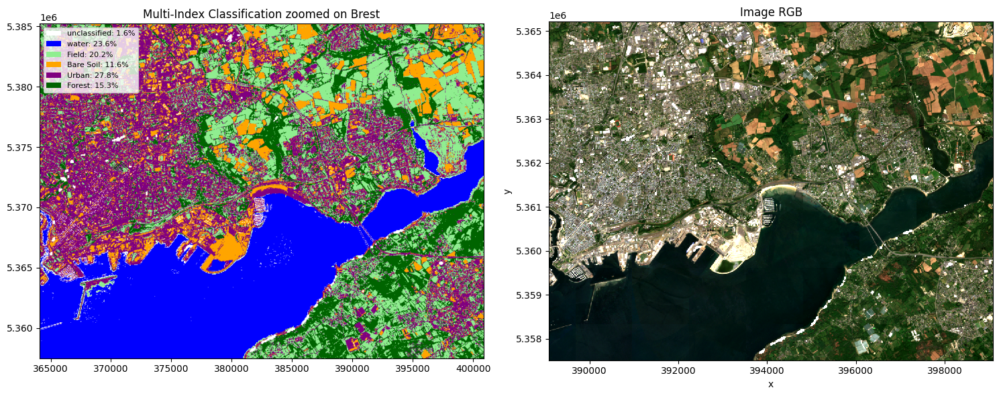

In [ ]:
y_start, y_end = 1500, 2000
x_start, x_end = 2000, 2500

y_start, y_end = 2000, 3000
x_start, x_end = 2500, 3500

#y_start, y_end = 1000, 1500
#x_start, x_end = 1500, 2000

ndvi_zoom = ndvi.isel(y=slice(y_start, y_end), x=slice(x_start, x_end))
mndwi_zoom = mndwi.isel(y=slice(y_start, y_end), x=slice(x_start, x_end))
nuai_zoom = nuai.isel(y=slice(y_start, y_end), x=slice(x_start, x_end))
bi_zoom = bi.isel(y=slice(y_start, y_end), x=slice(x_start, x_end))
bsi_zoom = bsi.isel(y=slice(y_start, y_end), x=slice(x_start, x_end))
chm_xr_zoom = chm_xr.isel(y=slice(y_start, y_end), x=slice(x_start, x_end))
ndbi_zoom = ndbi.isel(y=slice(y_start, y_end), x=slice(x_start, x_end))
colors = ["white", "blue", "lightgreen", "darkgreen", "orange", "purple"]
cmap = ListedColormap(colors)

#Rule base classification
water = water = (mndwi_zoom > 0) & (ndvi_zoom < 0.1) & (bi_zoom < 0.1) 
bare_soil_mask =  ( (bsi_zoom > 0.05)  & (nuai_zoom > 0.45) & (chm_xr_zoom < 3)  & (ndvi_zoom <0.4))  | ((bi_zoom > 0.15) & (mndwi_zoom < 0.05)) # to detect very bright surface
urban_mask = (((nuai_zoom > 0) & (nuai_zoom < 0.65))| ((ndbi_zoom >0.05)))  & (bi_zoom > 0.05)  & ~water & ~bare_soil_mask 
field = (ndvi_zoom >= 0.2) &   (chm_xr_zoom < 3) & ~water & ~urban_mask & ~bare_soil_mask
forest = (ndvi_zoom >= 0.4) & (chm_xr_zoom > 3) & ~water & ~urban_mask & ~bare_soil_mask  & ~field
Unclassified = ~water & ~urban_mask & ~bare_soil_mask  & ~field & ~forest

# Create classification
classified_element_zoomn = np.select(
    [water, field, forest, bare_soil_mask, urban_mask],
    [0, 1, 2, 3, 4],
    default=-1
)

# Statistiques
water_pct = (water.sum() / water.size * 100).values
field_pct = (field.sum() / field.size * 100).values
bare_pct = (bare_soil_mask.sum() / bare_soil_mask.size * 100).values
urban_pct = (urban_mask.sum() / urban_mask.size * 100).values
forest_pct = (forest.sum() / forest.size * 100).values
Unclassified_pct = (Unclassified.sum() / Unclassified.size * 100).values

# Plot
fig, axes = plt.subplots(1, 2, figsize=(15, 6))
im = axes[0].imshow(
    classified_element_zoomn,
    cmap=cmap,
    extent=[img_clean.x.min(), img_clean.x.max(),
            img_clean.y.min(), img_clean.y.max()],
    vmin=-1,
    vmax=4
)
img_clean.sel(band=[3,2,1]).isel(y=slice(y_start, y_end), x=slice(x_start, x_end)).plot.imshow(ax=axes[1], robust=True)

legend_elements = [
    Patch(facecolor='white', label=f'unclassified: {Unclassified_pct:.1f}%'),
    Patch(facecolor='blue', label=f'water: {water_pct:.1f}%'),
    Patch(facecolor='lightgreen', label=f'Field: {field_pct:.1f}%'),
    Patch(facecolor='orange', label=f'Bare Soil: {bare_pct:.1f}%'),
    Patch(facecolor='purple', label=f'Urban: {urban_pct:.1f}%'),
    Patch(facecolor='darkgreen', label=f'Forest: {forest_pct:.1f}%')
]

axes[0].legend(handles=legend_elements, loc='upper left', fontsize=8)

axes[0].set_title("Multi-Index Classification zoomed on Brest")
axes[1].set_title("Image RGB")
plt.tight_layout()
plt.show()


### 4.6 Saving the dataset

Now that we have our classification done, we can save this classification layer along with our spectral bands, indices, and height data into a single file.

In [113]:
# Combine all data into a single xarray Dataset
data_vars = {}
ref = img_clean.sel(band=1)  # Reference for coordinates

band_names = ['blue', 'green', 'red', 'nir', 'swir1', 'swir2', 'ndvi', 'mndwi', 'nuai', 'bsi', 'ndbi', 'bi', 'chm', 'classified']
band_data = [blue.data, green.data, red.data, nir.data, swir1.data, swir2.data, ndvi.data, mndwi.data, nuai.data, bsi.data, ndbi.data, bi.data, chm_xr.data,  classified_element.astype("int")]
for name, data in zip(band_names, band_data):
    data_vars[name] = (['y', 'x'], data)

cw = xr.Dataset(
        data_vars,
        coords={
            'y': ref.y.values,
            'x': ref.x.values
        }
    )
# Add metadata
cw.attrs['crs'] = img_clean.rio.crs.to_string()
cw.attrs['bands'] = band_names
cw.attrs['description'] = "Processed Sentinel-2 data with spectral bands, indices, CHM, and land cover classification."
cw.attrs['classification_legend'] = {
    0: 'Water',
    1: 'Field/Cropland',
    2: 'Forest',
    3: 'Bare Soil',
    4: 'Urban/Build-up',
    -1: 'Unclassified'
}

# saving the combined dataset to a .tif file
output_path = "data/processed_data/brest_processed_data2.tif"
cw.rio.to_raster(output_path)


### 4.7 Area statistics

In [114]:
# Calculate distribution statistics
unique, counts = np.unique(classified_element, return_counts=True)

print("\n" + "="*70)
print("  LAND COVER CLASSIFICATION STATISTICS")
print("="*70)

class_names = {
    -1: 'Unclassified',
    0: 'Water Bodies',
    1: 'Agricultural Fields',
    2: 'Forest',
    3: 'Bare Soil',
    4: 'Urban Areas'
}

print(f"\nClass Distribution:")
print("-"*70)
print(f"{'Class':<20} {'Pixels':>12} {'Percentage':>12} {'Area (km²)':>12}")
print("-"*70)

# Sentinel-2 pixel size: 10m x 10m = 100 m²
pixel_area_km2 = (10 * 10) / 1_000_000

for cls, count in zip(unique, counts):
    percentage = (count / classified_element.size) * 100
    area_km2 = count * pixel_area_km2
    print(f"{class_names[cls]:<20} {count:>12,} {percentage:>11.1f}% {area_km2:>11.2f}")

print("-"*70)
total_area = classified_element.size * pixel_area_km2
print(f"{'TOTAL':<20} {classified_element.size:>12,} {'100.0%':>12} {total_area:>11.2f}")
print("="*70)


  LAND COVER CLASSIFICATION STATISTICS

Class Distribution:
----------------------------------------------------------------------
Class                      Pixels   Percentage   Area (km²)
----------------------------------------------------------------------
Unclassified               86,744         0.9%        8.67
Water Bodies            2,095,492        20.6%      209.55
Agricultural Fields     4,356,464        42.7%      435.65
Forest                  1,037,178        10.2%      103.72
Bare Soil               1,511,340        14.8%      151.13
Urban Areas             1,103,612        10.8%      110.36
----------------------------------------------------------------------
TOTAL                  10,190,830       100.0%     1019.08


### 4.8 Result on the previous Ambazac area



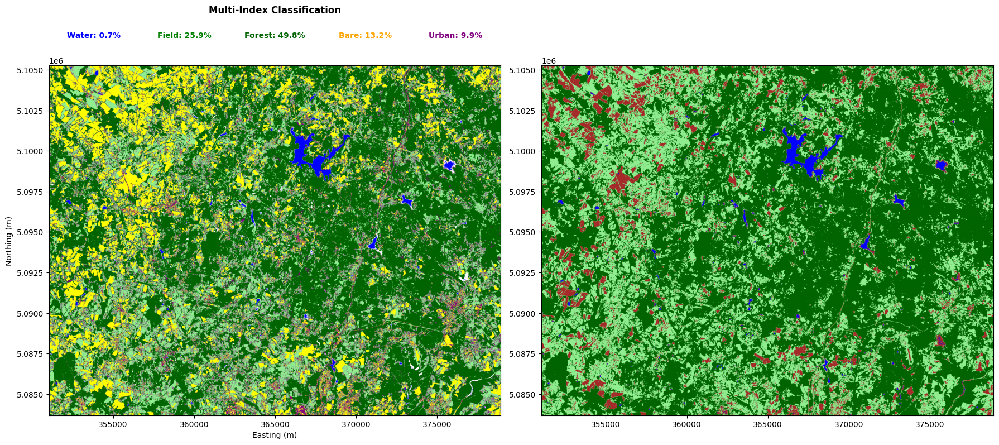

In the image above, we compare the new classification approach on the left with the old one on the right. We notice that our new approach is much more detailed - we can better distinguish between the different land cover types. This result demonstrates the robustness of our new multi-criteria method compared to the simpler approach from the previous article.